# Kinetic Energy

Mean and Eddy Kinetic Energy Decomposition 

## Theory

For a hydrostatic ocean like MOM5, the relevant kinetic energy per mass is 

$$ KE = \frac{1}{2} (u^2 + v^2).$$

The vertical velocity component, $w$, does not appear in the mechanical energy budget. It is very much subdominant. But more fundamentally, it simply does not appear in the mechanical energy buget for a hydrostatic ocean. 

For a non-steady fluid, we can define the time-averaged kinetic energy as the __total kinetic energy__, TKE

$$ TKE = \left< K \right > = \frac{1}{T} \int_0^T \frac{1}{2} \left( u^2 + v^2 \right) dt $$

It is useful to decompose the velocity in the mean and time varying components

$$ u = \bar{u} + u'$$

The __mean kinetic energy__ is the energy associated with the mean flow

$$ MKE = \frac{1}{2} \left( \bar{u}^2 + \bar{v}^2 \right) $$

The kinetic energy of the time varying component is the __eddy kinetic energy__, EKE. This quantity can be obtained by 
substracting the velocity means and calculating the kinetic energy of the 
perturbation velocity quantities.

$$ EKE =  \overline{ \frac{1}{2} \left[ \left(u - \overline{u}\right)^2 + \left(v - \overline{v}\right)^2 \right] } $$
                                 
MKE and EKE partition the total kinetic energy

$$TKE = EKE + MKE $$


## Calculation


We start by importing some useful packages.

In [1]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

import cosima_cookbook as cc

from cosima_cookbook import distributed as ccd

import matplotlib.pyplot as plt
import numpy as np
import cmocean as cm
import xarray as xr

from dask.distributed import Client

Import cartopy to plot maps:

In [2]:
import cartopy.crs as ccrs
import cartopy.feature as feature

land_50m = feature.NaturalEarthFeature('physical', 'land', '50m',
                                        edgecolor='black',
                                        facecolor='gray',
                                        linewidth=0.2)

Start up a dask cluster.

In [3]:
client = Client(n_workers=20)
client

Client Scheduler: tcp://127.0.0.1:41905 Dashboard: /proxy/8787/status,Cluster Workers: 20 Cores: 40 Memory: 103.08 GB


Create a database session and select an experiment. Here we choose an experiment which has daily velocities saved for the Southern Ocean.

In [4]:
session = cc.database.create_session()
expt = '01deg_jra55v13_ryf9091'

While not difficult to write down, this is fairly involved computation since to compute the eddy kinetic energy requires both the velocity and the mean of the velocity components.  Since the dataset is large, we want to avoid loading all of the velocity data into memory at the same time.

To calculate EKE, we need horizontal velocities $u$ and $v$, preferably saved at `1 daily` frequency (or perhaps `5 daily`). You can check whether your experiment has that kind of data:

In [5]:
varlist = cc.querying.get_variables(session, expt,frequency = '1 daily')
varlist

,name,frequency,ncfile,# ncfiles,time_start,time_end
0,average_DT,1 daily,output675/ocean/ocean_daily.nc,481,1950-01-01 00:00:00,2070-01-01 00:00:00
1,average_T1,1 daily,output675/ocean/ocean_daily.nc,481,1950-01-01 00:00:00,2070-01-01 00:00:00
2,average_T2,1 daily,output675/ocean/ocean_daily.nc,481,1950-01-01 00:00:00,2070-01-01 00:00:00
3,eta_t,1 daily,output675/ocean/ocean_daily.nc,479,1950-01-01 00:00:00,2070-01-01 00:00:00
4,frazil_3d_int_z,1 daily,output675/ocean/ocean_daily.nc,454,1956-04-01 00:00:00,2070-01-01 00:00:00
5,mld,1 daily,output675/ocean/ocean_daily.nc,479,1950-01-01 00:00:00,2070-01-01 00:00:00
6,nv,1 daily,output675/ocean/ocean_daily.nc,481,1950-01-01 00:00:00,2070-01-01 00:00:00
7,pme_river,1 daily,output675/ocean/ocean_daily.nc,454,1956-04-01 00:00:00,2070-01-01 00:00:00
8,salt,1 daily,output279/ocean/ocean_daily_3d_salt_12.nc,252,1950-01-01 00:00:00,1971-01-01 00:00:00
9,sfc_hflux_coupler,1 daily,output675/ocean/ocean_daily.nc,454,1956-04-01 00:00:00,2070-01-01 00:00:00


### Example

For example, let's calculate the mean and eddy kinetic energy over the last two months of this particular model run:

In [6]:
start_time = '1970-12-01'

Here we build datasets for the variables u and v

In [7]:
u = cc.querying.getvar(expt, 'u', session, ncfile='ocean_daily_3d_u_%.nc', start_time = start_time)
v = cc.querying.getvar(expt, 'v', session, ncfile='ocean_daily_3d_v_%.nc', start_time = start_time)

/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_u_11.nc', 'ocean_daily_3d_u_12.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "
/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_v_12.nc', 'ocean_daily_3d_v_11.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "


The kinetic energy is given by

$$ KE = \frac{1}{2} (u^2 + v^2)$$

we construct the following expression:

In [8]:
KE = 0.5*(u**2 + v**2)

You may notice that this line takes only a moment to run. The calculation is not (yet) being run. Rather, XArray needs to broadcast the squares of the velocity fields together to determine the final shape of KE. 

This is too large to store locally.  We need to reduce the data in some way.  

The mean kinetic energy is calculated by this function, which returns the depth integrated KE:

$$ \int_{z_0}^{z} KE dz$$

In [9]:
dz = np.gradient(KE.st_ocean)[:, np.newaxis, np.newaxis]
KE_dz = KE*dz

MKE = KE_dz.mean('time').sum('st_ocean')

`MKE.plot()` won't work because of this and that... We have to do more magic...

We compute this DataArray using the new `map_blocks` function:

Now using the CC framework:

In [10]:
%%time
MKE_v3 = ccd.compute_by_block(MKE)

CPU times: user 1min 13s, sys: 4.53 s, total: 1min 17s
Wall time: 1min 53s


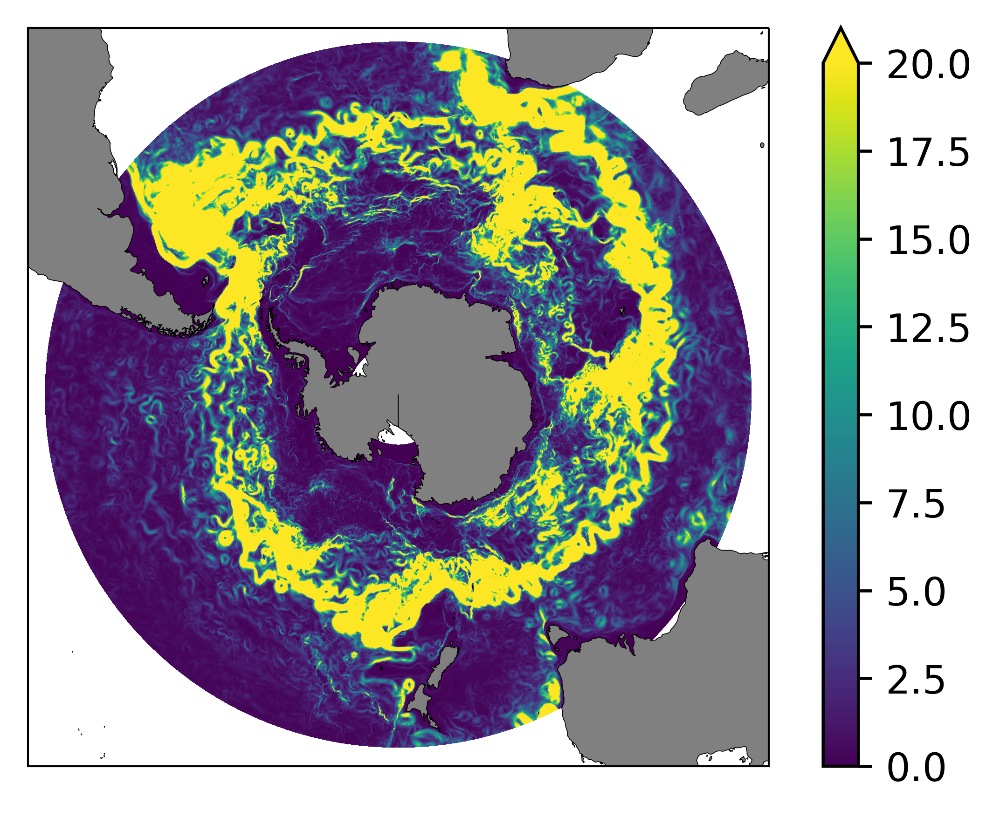

In [11]:
fig = plt.figure(figsize=(5, 3.5), dpi=300)

ax = fig.add_subplot(1, 1, 1, projection=ccrs.SouthPolarStereo())

MKE_v3.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=20)

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

Snapshot plot of depth integrated KE for 1970-12-01

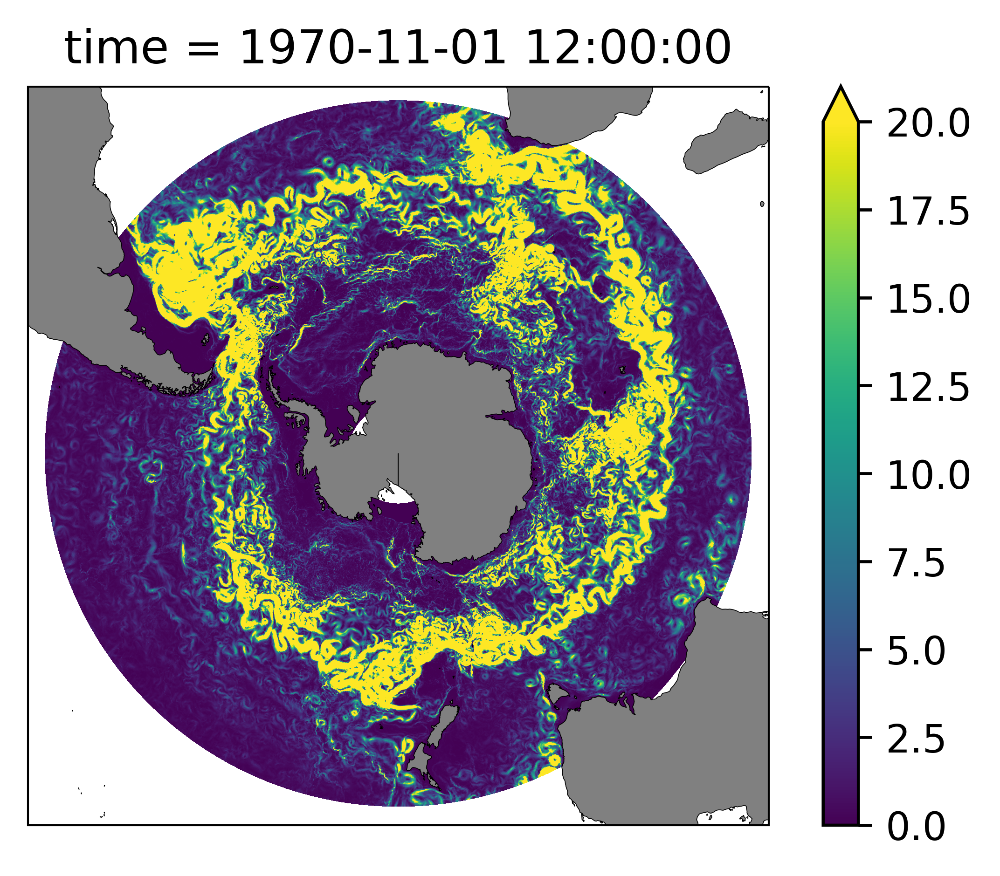

In [12]:
fig = plt.figure(figsize=(5, 3.5), dpi=300)

ax = fig.add_subplot(1, 1, 1, projection=ccrs.SouthPolarStereo())

KE_dz.isel(time=0).sum('st_ocean').plot(vmax=20, transform=ccrs.PlateCarree());

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

## Mean Kinetic Energy

For the mean kinetic energy, we need to average the velocities over time over time.

$$ MKE = \frac{1}{2} \left( \bar{u}^2 + \bar{v}^2 \right) $$

In [13]:
u_mean = u.mean('time')
v_mean = v.mean('time')

In [14]:
MKE = (0.5*(u_mean**2 + v_mean**2)*dz).sum('st_ocean')

In [15]:
%%time
MKE = ccd.compute_by_block(MKE)

distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)


CPU times: user 1min 13s, sys: 4.1 s, total: 1min 17s
Wall time: 1min 38s


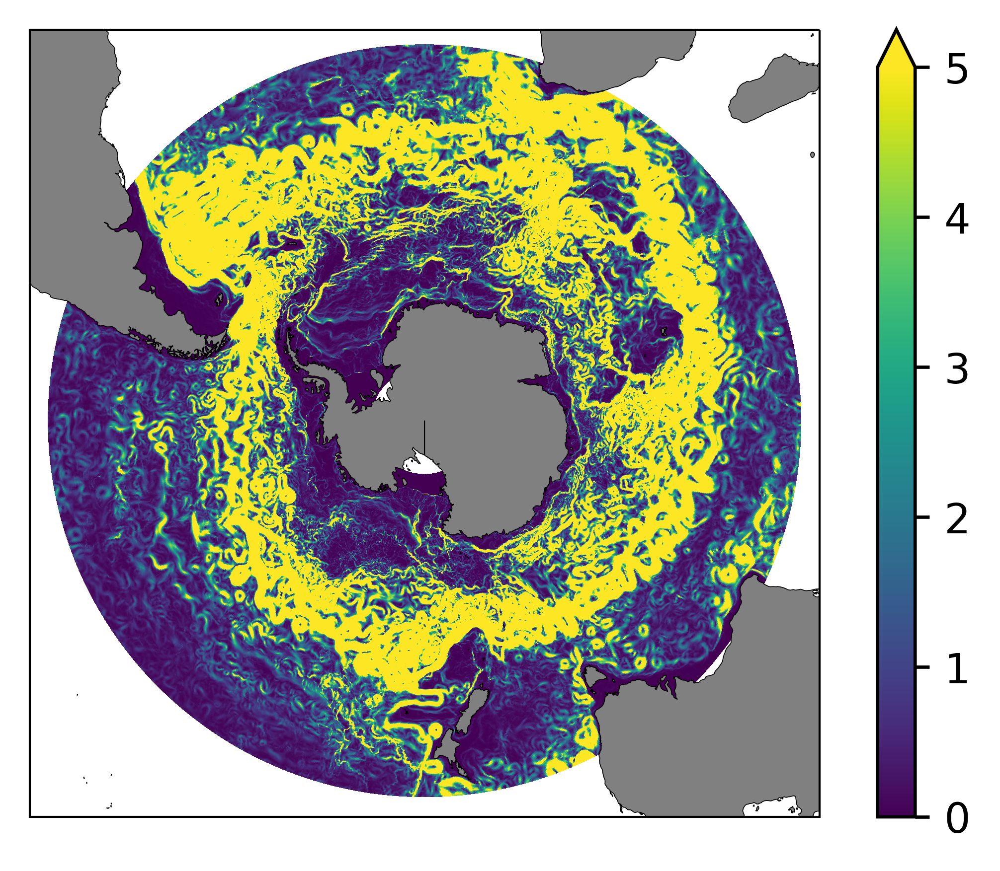

In [16]:
fig = plt.figure(figsize=(5, 3.5),dpi=300)

ax = fig.add_subplot(1, 1, 1, projection=ccrs.SouthPolarStereo())

MKE.plot(ax=ax,transform=ccrs.PlateCarree(), vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

## Eddy Kinetic Energy

We calculate the perturbation velocities


$$ EKE =  \overline{ \frac{1}{2} \left[ \left(u - \overline{u}\right)^2 + \left(v - \overline{v}\right)^2 \right] } $$

In [17]:
u_transient = u - u_mean
v_transient = v - v_mean

In [18]:
EKE = (0.5*(u_transient**2 + v_transient**2)*dz).mean('time').sum('st_ocean')

In [19]:
EKE = ccd.compute_by_block(EKE)

distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

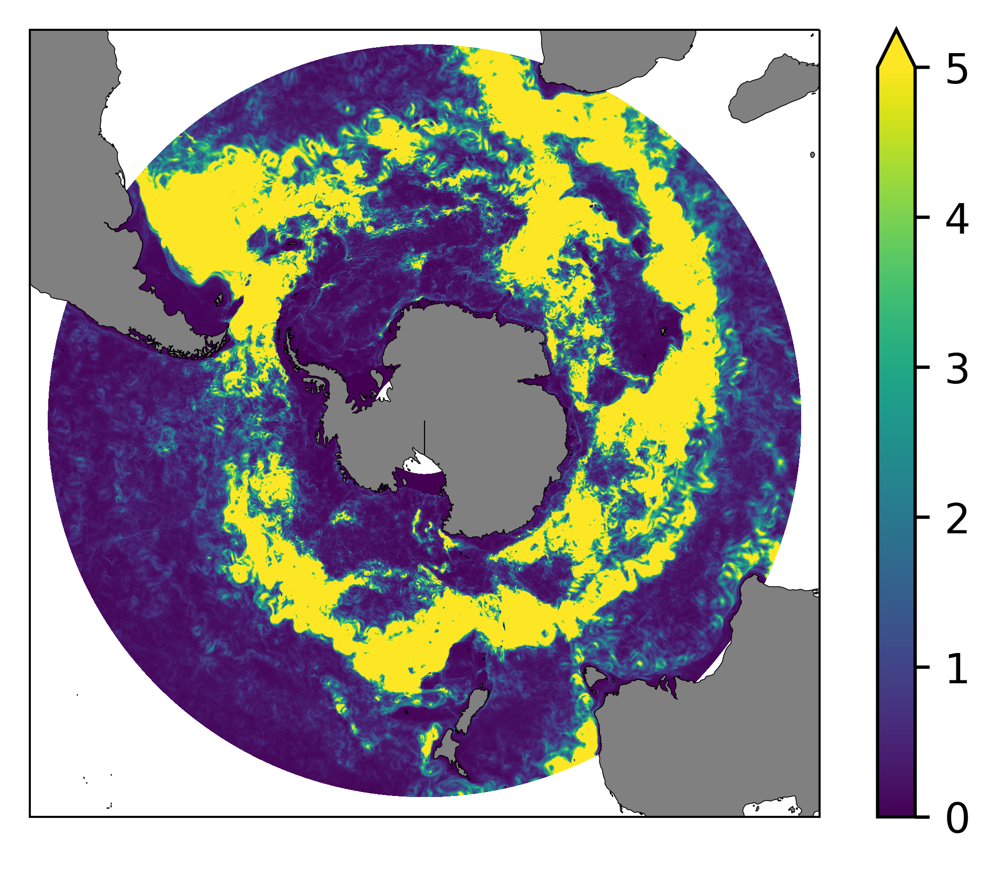

In [20]:
fig = plt.figure(figsize=(5, 3.5),dpi=300)

ax = fig.add_subplot(1, 1, 1, projection= ccrs.SouthPolarStereo())

EKE.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

# Functions using the CC framework and dask.
(Functions of previously described code)

In [22]:
from joblib import Memory

memory = Memory(cachedir='/g/data/v45/cosima-cookbook/', verbose=0)

/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: The 'cachedir' parameter has been deprecated in version 0.12 and will be removed in version 0.14.
You provided "cachedir='/g/data/v45/cosima-cookbook/'", use "location='/g/data/v45/cosima-cookbook/'" instead.
  This is separate from the ipykernel package so we can avoid doing imports until


In [23]:
from cosima_cookbook.netcdf_index import get_nc_variable

Here are functions for calculating both MKE and EKE using `Cosima-Cookbook`.

In [24]:
@memory.cache
def calc_mke(expt, n=6, start_time='2000-01-01'):
    
    print('Opening datasets...')
    u = cc.querying.getvar(expt, 'u', session, ncfile='ocean_daily_3d_u_%.nc', start_time=start_time)
    v = cc.querying.getvar(expt, 'v', session, ncfile='ocean_daily_3d_v_%.nc', start_time=start_time)
    
    print('Preparing computation...')
    u_mean = u.mean('time')
    v_mean = v.mean('time')
    dz = np.gradient(KE.st_ocean)[:, np.newaxis, np.newaxis]

    MKE_cc = (0.5*(u_mean**2 + v_mean**2)*dz).sum('st_ocean')
    
    print('Calculating...')
    MKE_result = ccd.compute_by_block(MKE_cc)
    
    return MKE_result

In [25]:
%%time
MKE_cc = calc_mke(expt, n=24, start_time=start_time)

Opening datasets...


/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_u_11.nc', 'ocean_daily_3d_u_12.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "
/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_v_12.nc', 'ocean_daily_3d_v_11.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "


Preparing computation...
Calculating...


CPU times: user 1min 15s, sys: 4.12 s, total: 1min 20s
Wall time: 1min 40s


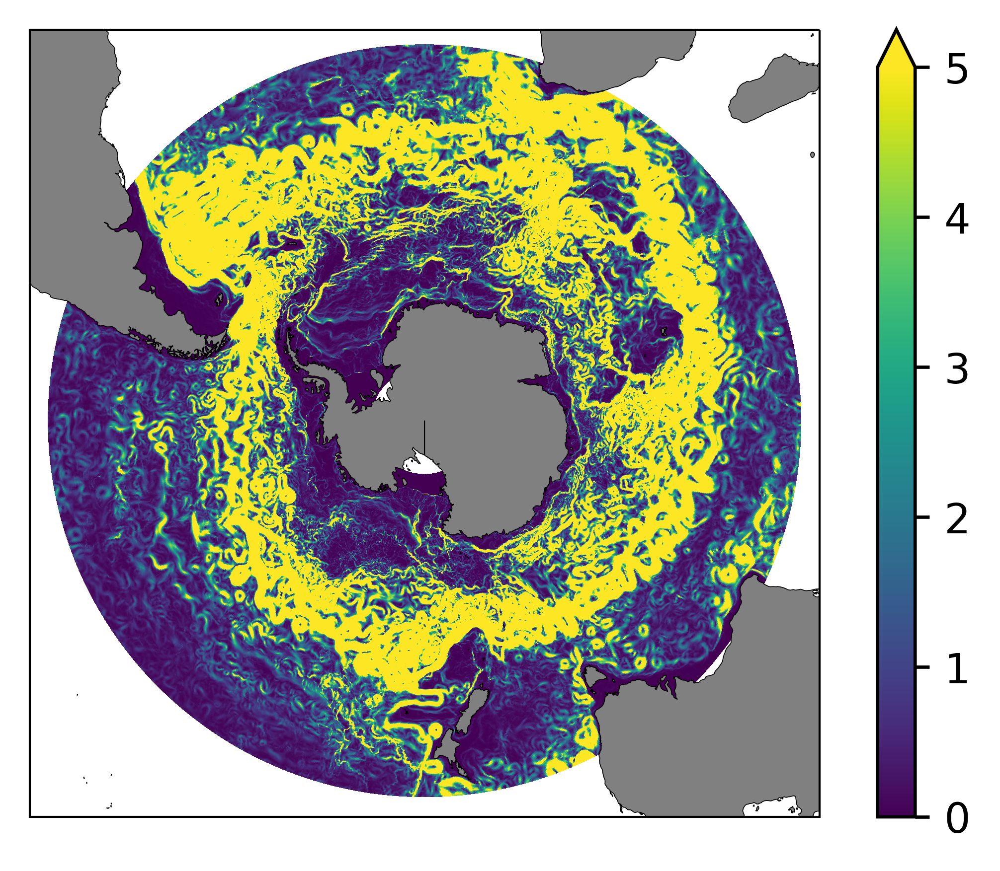

In [26]:
fig = plt.figure(figsize=(5, 3.5), dpi=300)

ax = fig.add_subplot(1, 1, 1, projection= ccrs.SouthPolarStereo())

MKE_cc.plot(ax=ax, transform=ccrs.PlateCarree(),vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

In [27]:
@memory.cache
def calc_eke(expt, n=6, start_time='2000-01-01'):
    
    print('Opening datasets...')
    u = cc.querying.getvar(expt, 'u', session, ncfile='ocean_daily_3d_u_%.nc', start_time=start_time)
    v = cc.querying.getvar(expt, 'v', session, ncfile='ocean_daily_3d_v_%.nc', start_time=start_time)
    
    print('Preparing computation...')
    u_mean = u.mean('time')
    v_mean = v.mean('time')
    
    dz = np.gradient(KE.st_ocean)[:, np.newaxis, np.newaxis]
    
    u_transient = u - u_mean
    v_transient = v - v_mean
    EKE_cc = (0.5*(u_transient**2 + v_transient**2)*dz).mean('time').sum('st_ocean')

    print('Calculating...')
    EKE_result = ccd.compute_by_block(EKE_cc)
    
    return EKE_result

In [28]:
%%time
EKE_cc = calc_eke(expt, n=24, start_time=start_time)

Opening datasets...


/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_u_11.nc', 'ocean_daily_3d_u_12.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "
/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_v_12.nc', 'ocean_daily_3d_v_11.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "


Preparing computation...
Calculating...


CPU times: user 1min 53s, sys: 7.38 s, total: 2min 1s
Wall time: 2min 49s


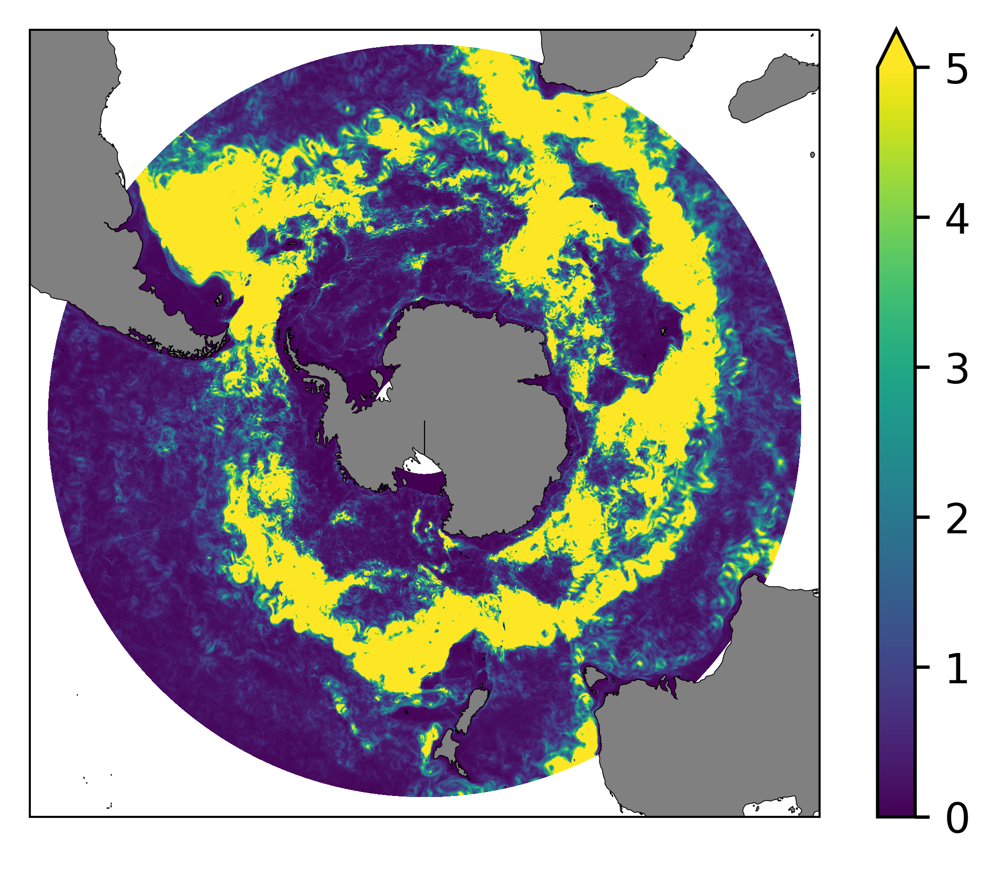

In [29]:
fig = plt.figure(figsize=(5, 3.5),dpi=300)

ax = fig.add_subplot(1, 1, 1,projection= ccrs.SouthPolarStereo())

EKE_cc.plot(ax=ax,transform=ccrs.PlateCarree(), vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

## Implementation of dask directly

Note: This example work but performance could be improved (it requires further debugging).

In [30]:
import netCDF4
import dask.array as da

In [31]:
@memory.cache
def calc_mke_dask(expt, n=72):

    #Identify files and paths for u and v.
    ncfiles=[str(f[0].ncfile_path)  for f in cc.querying._ncfiles_for_variable(expt, 'u', session) if 'ocean_daily_3d' in str(f[0].ncfile_path) ]
    u_ncfiles=ncfiles[-3:]
    
    ncfiles=[str(f[0].ncfile_path)  for f in cc.querying._ncfiles_for_variable(expt, 'v', session) if 'ocean_daily_3d' in str(f[0].ncfile_path) ]
    v_ncfiles=ncfiles[-3:]

    #Construct datasets
    u_dataarrays = [da.from_array(netCDF4.Dataset(ncfile, 'r')['u'],
            chunks=(1, 7, 300, 400)) for ncfile in u_ncfiles]
    u = da.concatenate(u_dataarrays, axis=0)

    v_dataarrays = [da.from_array(netCDF4.Dataset(ncfile, 'r')['v'],
            chunks=(1, 7, 300, 400)) for ncfile in v_ncfiles]
    v = da.concatenate(v_dataarrays, axis=0)

    #Make sure to mask fillvalue.
    u[u==netCDF4.Dataset(u_ncfiles[0], 'r')['u'].getncattr('_FillValue')]=np.nan
    v[v==netCDF4.Dataset(v_ncfiles[0], 'r')['v'].getncattr('_FillValue')]=np.nan
    
    #Compute averages with nan.
    u_mean = da.nanmean(u, axis=0)
    v_mean = da.nanmean(v, axis=0)
    
    # Create temporal xarray structure
    temp = cc.querying.getvar(expt, 'u', session,ncfile='ocean_daily_3d_u_%.nc', start_time = start_time).isel(time=-1)
    
    # Define dz for intergral on depth.
    dz = np.gradient(temp.st_ocean)[:, np.newaxis, np.newaxis]
    
    #Compute MKE
    MKEdensity = 0.5 * (u_mean**2 + v_mean**2)
    MKE_int = da.nansum(MKEdensity*dz, axis=0)
    
    MKE = ccd.compute_by_block(MKE_int)
    
    #Store files
    template = temp.sum('st_ocean')
    result = xr.zeros_like(template).compute()
    result[:] = MKE
    result.name = 'MKE'
    
    return result

In [32]:
%%time
MKE_v2 = calc_mke_dask(expt, n=24)

/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_u_02.nc', 'ocean_daily_3d_u_08.nc', 'ocean_daily_3d_u_10.nc', 'ocean_daily_3d_u_06.nc', 'ocean_daily_3d_u_05.nc', 'ocean_daily_3d_u_12.nc', 'ocean_daily_3d_u_11.nc', 'ocean_daily_3d_u_07.nc', 'ocean.nc', 'ocean_daily_3d_u_09.nc', 'ocean_daily_3d_u_04.nc', 'ocean_daily_3d_u_03.nc', 'ocean_daily_3d_u_01.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "
/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_v_03.nc', 'ocean_daily_3d_v_10.nc', 'ocean_daily_3d_v_07.nc', 'ocean_daily_3d_v_12.nc', '

CPU times: user 2min 4s, sys: 6 s, total: 2min 10s
Wall time: 2min 42s


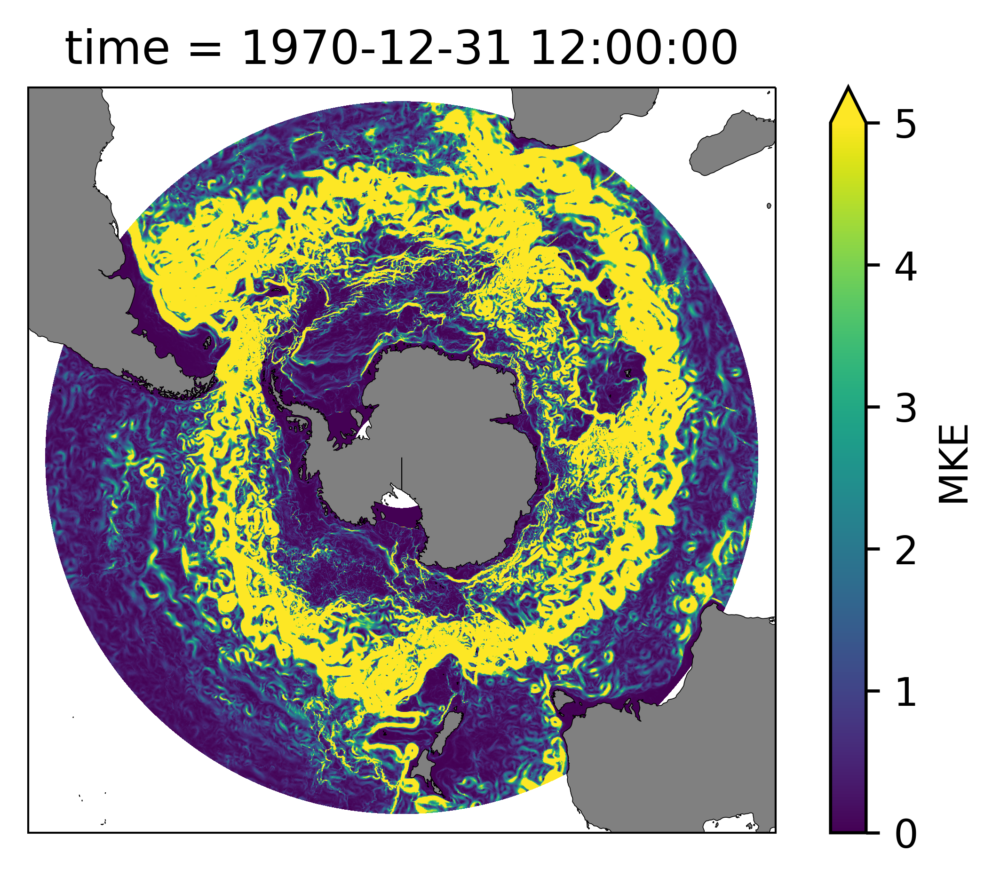

In [33]:
fig = plt.figure(figsize=(5, 3.5),dpi=300)

ax = fig.add_subplot(1, 1, 1,projection= ccrs.SouthPolarStereo())

MKE_v2.plot(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

In [37]:
@memory.cache
def calc_eke_dask(expt, n=72):

    ncfiles=[str(f[0].ncfile_path)  for f in cc.querying._ncfiles_for_variable(expt, 'u', session) if 'ocean_daily_3d' in str(f[0].ncfile_path) ]
    u_ncfiles=ncfiles[-3:]
    
    ncfiles=[str(f[0].ncfile_path)  for f in cc.querying._ncfiles_for_variable(expt, 'v', session) if 'ocean_daily_3d' in str(f[0].ncfile_path) ]
    v_ncfiles=ncfiles[-3:]

    u_dataarrays = [da.from_array(netCDF4.Dataset(ncfile, 'r')['u'],
            chunks=(1, 7, 300, 400)) for ncfile in u_ncfiles]
    u = da.concatenate(u_dataarrays, axis=0)

    v_dataarrays = [da.from_array(netCDF4.Dataset(ncfile, 'r')['v'],
            chunks=(1, 7, 300, 400)) for ncfile in v_ncfiles]
    v = da.concatenate(v_dataarrays, axis=0)
    
    u[u==netCDF4.Dataset(u_ncfiles[0], 'r')['u'].getncattr('_FillValue')]=np.nan
    v[v==netCDF4.Dataset(v_ncfiles[0], 'r')['v'].getncattr('_FillValue')]=np.nan

    u_mean = da.nanmean(u,axis=0)
    v_mean = da.nanmean(v,axis=0)
    
    # Create temporal xarray structure
    temp = cc.querying.getvar(expt,'u',session,ncfile='ocean_daily_3d_u_%.nc',start_time = start_time).isel(time=-1)
    
    # Define dz for intergral on depth.
    dz = np.gradient(temp.st_ocean)[:, np.newaxis, np.newaxis]
    
    u_transient = u - u_mean
    v_transient = v - v_mean

    EKEdensity = 0.5 * (u_transient**2 + v_transient**2)
    EKEmeantime = da.nanmean(EKEdensity,axis=0)
    EKEsum = da.nansum(EKEmeantime*dz,axis=0)
    
    EKE_dask = ccd.compute_by_block(EKEsum)
    
    template = temp.sum('st_ocean')
    result = xr.zeros_like(template).compute()
    result[:] = EKE_dask
    result.name = 'EKE'
    
    return result

In [38]:
%%time
EKE_v2 = calc_eke_dask(expt, n=24)

/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_u_02.nc', 'ocean_daily_3d_u_08.nc', 'ocean_daily_3d_u_10.nc', 'ocean_daily_3d_u_06.nc', 'ocean_daily_3d_u_05.nc', 'ocean_daily_3d_u_12.nc', 'ocean_daily_3d_u_11.nc', 'ocean_daily_3d_u_07.nc', 'ocean.nc', 'ocean_daily_3d_u_09.nc', 'ocean_daily_3d_u_04.nc', 'ocean_daily_3d_u_03.nc', 'ocean_daily_3d_u_01.nc'}. This could lead to unexpected behaviour! Disambiguate by passing ncfile= to getvar, specifying the desired file.
  f"Your query gets a variable from differently-named files: {unique_files}. "
/g/data3/hh5/public/apps/miniconda3/envs/analysis3-20.01/lib/python3.7/site-packages/cosima_cookbook/querying.py:190: UserWarning: Your query gets a variable from differently-named files: {'ocean_daily_3d_v_03.nc', 'ocean_daily_3d_v_10.nc', 'ocean_daily_3d_v_07.nc', 'ocean_daily_3d_v_12.nc', '

CPU times: user 3min 1s, sys: 8.41 s, total: 3min 9s
Wall time: 3min 53s


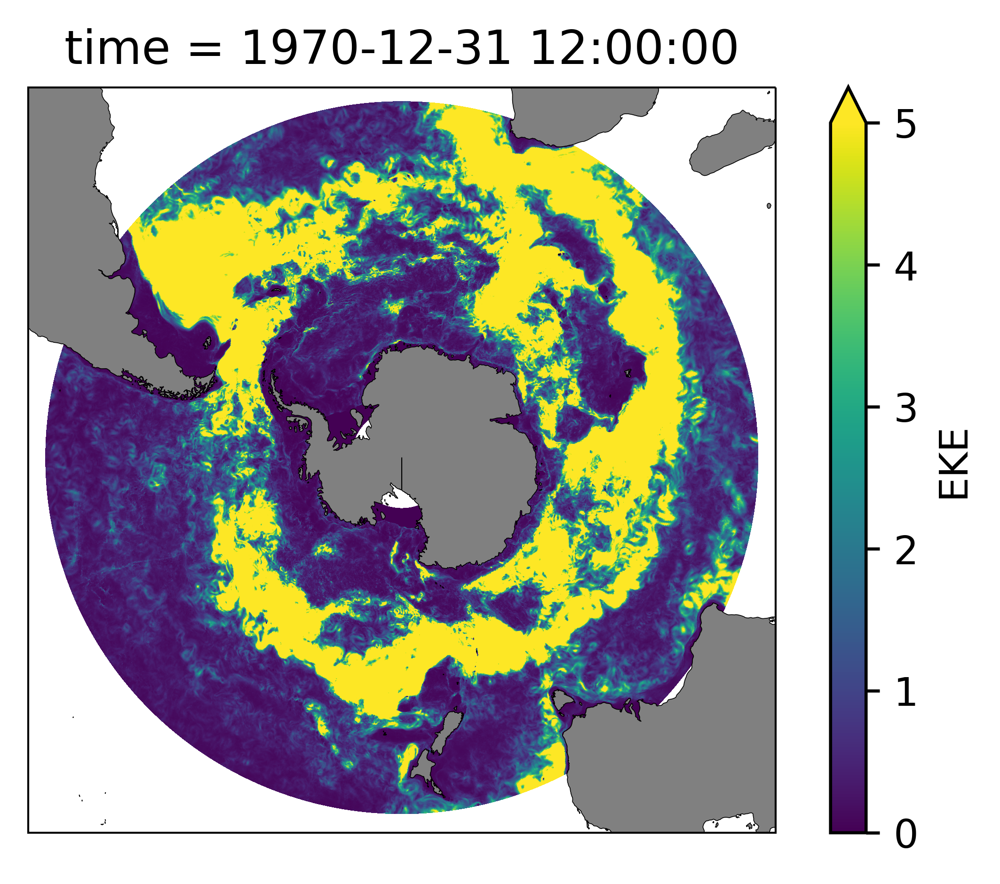

In [39]:
fig = plt.figure(figsize=(5, 3.5),dpi=300)

ax = fig.add_subplot(1, 1, 1,projection= ccrs.SouthPolarStereo())

EKE_v2.plot(ax=ax,transform=ccrs.PlateCarree(),vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

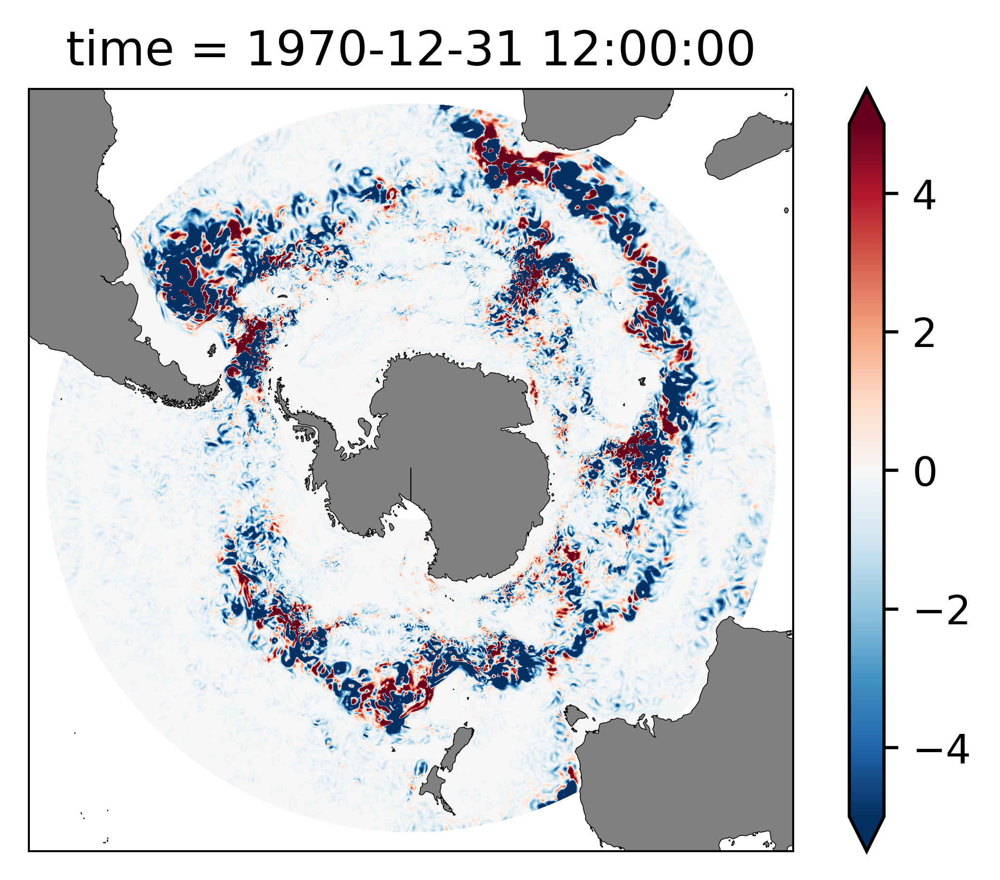

In [40]:
fig = plt.figure(figsize=(5, 3.5),dpi=300)

ax = fig.add_subplot(1, 1, 1,projection= ccrs.SouthPolarStereo())

(EKE-EKE_v2).plot(ax=ax, transform=ccrs.PlateCarree(), vmax=5);

ax.set_extent([-180, 180, -90, -30], ccrs.PlateCarree())
ax.add_feature(land_50m, zorder=2)
ax.outline_patch.set_linewidth(0.5)

Note the walltime of the CC implementation takes between 1min 40s to 2min 49s for MKE and EKE respectively to analyze 61 days of data. Meanwhile, the dask-netCDF4 implementation used 2min 42s and 3min 53s to analyze 92 days of data. Overall, the CC implementation takes between 1.7 to 2.7s/day, while the dask implementation corresponds to 1.7 to 2.5s/day.

In [51]:
(3*60+53)/92

2.532608695652174